In [55]:
import numpy as np
import matplotlib.pyplot as plt 
import skimage.io as io
import matplotlib.patches as pt
import os as os

D:\Anaconda_Installed\lib\site-packages\matplotlib\cbook\deprecation.py:107: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)
D:\Anaconda_Installed\lib\site-packages\matplotlib\pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


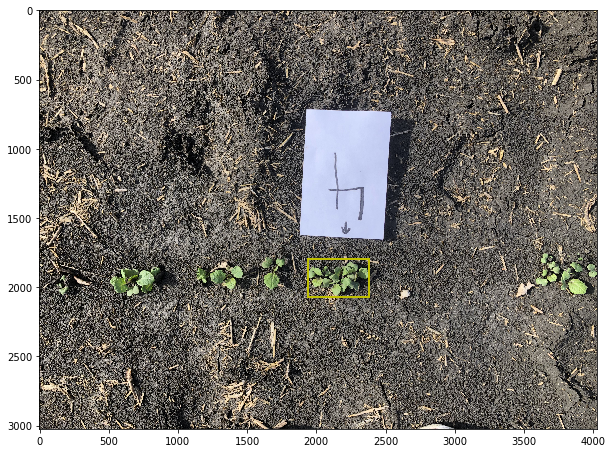

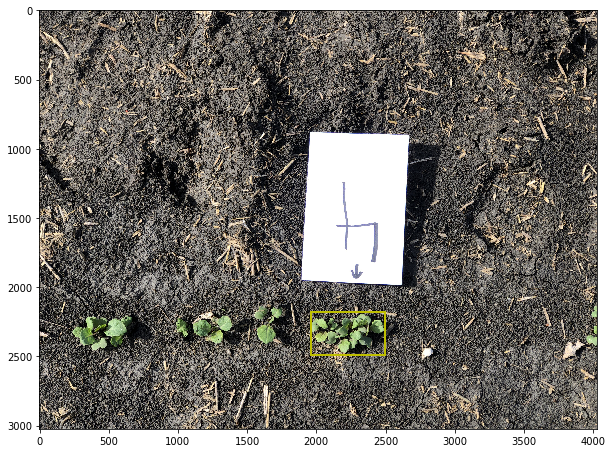

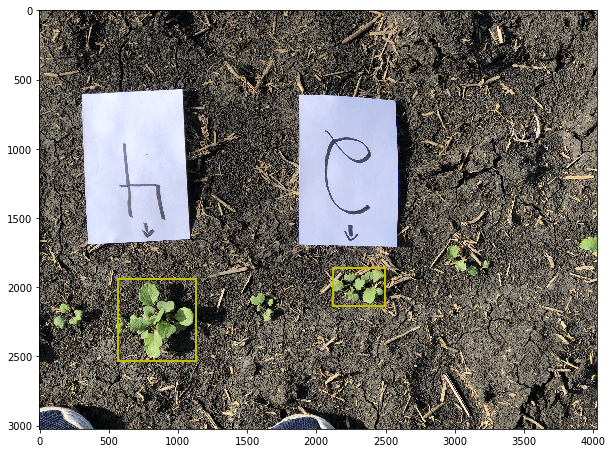

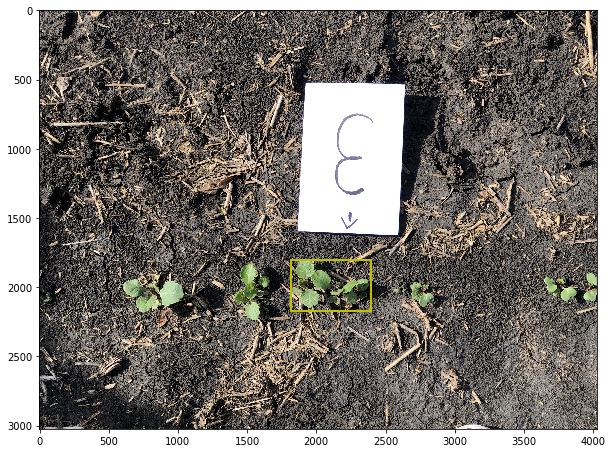

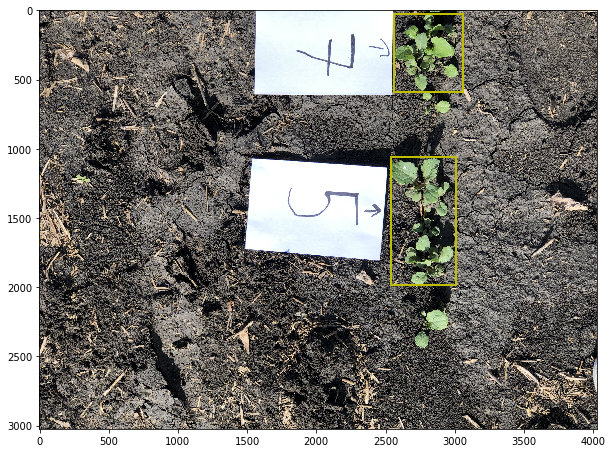

...

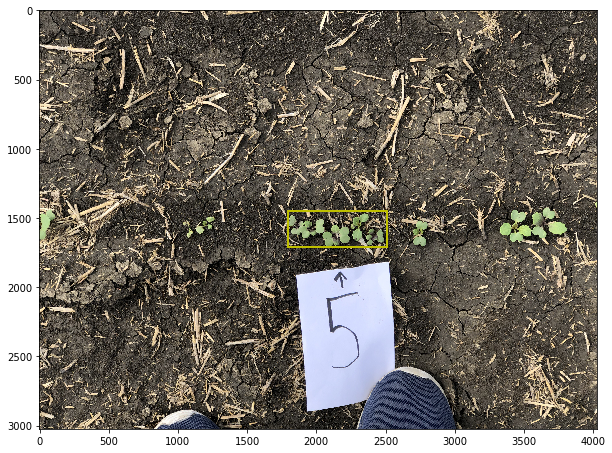

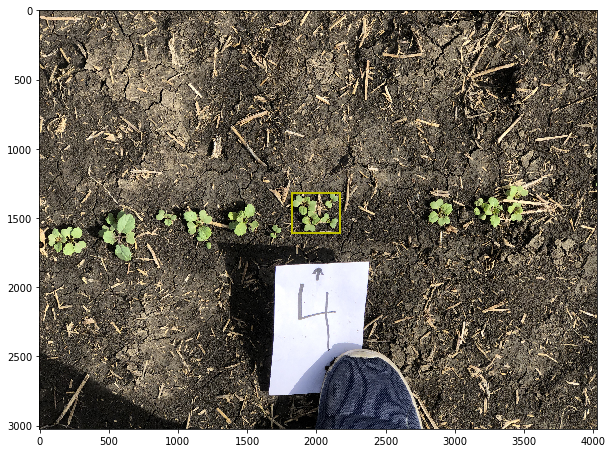

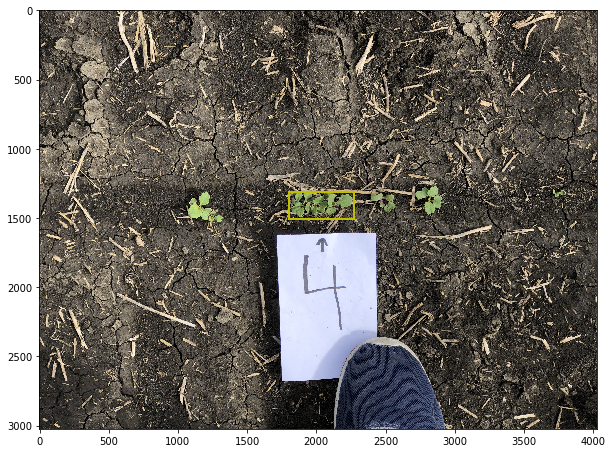

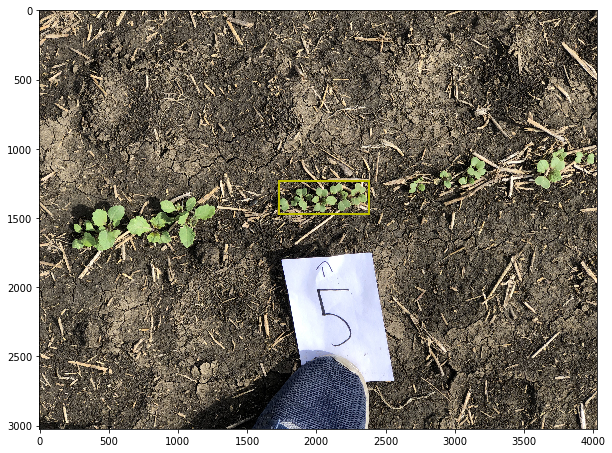

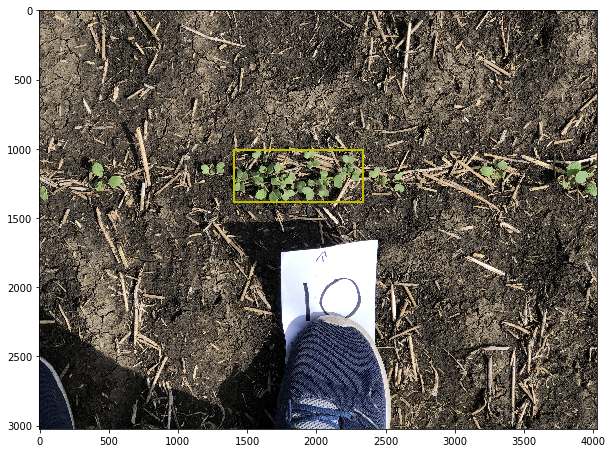

In [63]:
dir_name='Umair' # This assumes that both image and annotation directories are in your pwd
images_path = os.path.join('.', dir_name)

for root, dirs, files in os.walk(images_path):
    for filename in files:
        image = io.imread(root+'//'+filename)
        annotations_file = open(dir_name+'_annotations'+'/'+filename.replace(".JPG",".txt"),"r")
        fig = plt.figure(figsize=(10,10))
        boxes = annotations_file.readlines()
        for box in boxes:
            coordinates = np.array(box.split())
            coordinates = coordinates.astype(np.float)
            x = (coordinates[1] - coordinates[3]/2)*image.shape[1]
            y = (coordinates[2] - coordinates[4]/2)*image.shape[0]
            rect = pt.Rectangle((x,y),coordinates[3]*image.shape[1],coordinates[4]*image.shape[0],linewidth=2,edgecolor='y',facecolor='none')
            ax2 = fig.add_subplot(111, aspect='equal')
            ax2.add_patch(rect)
        plt.imshow(image)